# A Brief Crash Course in Compton Imaging

## There are two main approaches to imaging:
1. Fitting method
2. Richardson-Lucy deconvolution

## 1. Fitting method

The instrument **response** takes our data from physical to measured units.

What *is* the response?

A bit of mathematical notation can help. Consider the response as a function of coordinates:

$R(Z, A; \phi, \psi, \chi)$

Z = zenith (angle in instrument coordinates)

A = azimuth (angle in instrument coordinates)

$(\phi, \psi, \chi)$ are the CDS angles. 

Note that Z and A point to a spot on the sky via a unique mapping of $(Z, A)$ <--> $(\ell, b)$, i.e. Galactic longitude and latitude. This mapping is calculated with "Great Circles," trig functions, etc. 

When we measure, we essentially sort photons from the sky into our data space (the CDS). We can picture this as a cube, since there are three parameters (ignore the colors):

In [1]:
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider, Button
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import dash
from dash import html
from dash import dcc

In [2]:
%matplotlib notebook

<IPython.core.display.Javascript object>


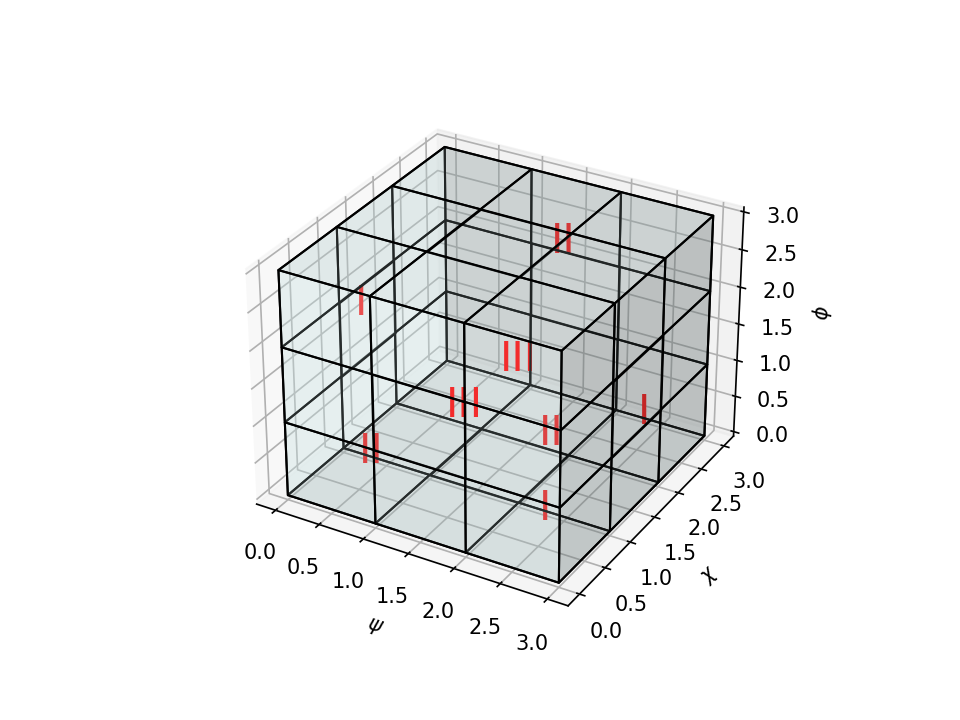

In [3]:
# {
#     "tags": [
#         "hide_input",
#     ]
# }


# From matplotlib docs, create a 3D voxel/volumetric plot: 
#      https://matplotlib.org/stable/gallery/mplot3d/voxels.html
# prepare some coordinates
x, y, z = np.indices((3, 3, 3))

# draw cuboids in the top left and bottom right corners, and a link between
# them
cube1 = (x < 3) & (y < 3) & (z < 3)

# combine the objects into a single boolean array
voxelarray = cube1

# set the colors of each object
colors = np.empty(voxelarray.shape, dtype=object)
colors[cube1] = 'lightcyan'

# and plot everything
ax = plt.figure().add_subplot(projection='3d')
ax.voxels(voxelarray, facecolors=colors, edgecolor='k', alpha=0.2)


# Axis labels
ax.set_xlabel(r'$\psi$')
ax.set_ylabel(r'$\chi$')
ax.set_zlabel(r'$\phi$')

# Annotations
ax.text(0.5, 0.5, 2.3, 'I', c='red', fontsize=20)
ax.text(1.5, 1.5, 1.3, 'III', c='red', fontsize=20)
ax.text(1.5, 0.5, 1.3, 'III', c='red', fontsize=20)
ax.text(2.5, 2.5, 0.3, 'I', c='red', fontsize=20)
ax.text(2.5, 0.5, 0.3, 'I', c='red', fontsize=20)
ax.text(0.5, 0.5, 0.3, 'II', c='red', fontsize=20)
ax.text(2.5, 0.5, 1.3, 'II', c='red', fontsize=20)
ax.text(1.5, 2.5, 2.3, 'II', c='red', fontsize=20)

plt.show()

This drawing shows the CDS (arbitrarily) binned with 4 bins in each of $\phi, \psi$, and $\chi$. 

Each measured photon falls into one of these bins, such that we get 0, 1, 2, 3, etc. in each. Again, this is what we measure.

Now, the response is like an effective area (units: cm$^2$) which takes the sky counts to the CDS:

$\int R_{CDS}^{ZA} S(\ell, b; \vec{\alpha})_{ZA} d\Omega =$ cm$^2 \cdot$ ph cm$^{-2}$ s$^{-1}$ sr$^{-1} \cdot$ sr = ph s$^{-1}$, 

i.e. a rate, which makes sense because the Poisson distribution refers to rates anyway. We have a sky distribution dependent on Galacic Coordinates $(\ell, b)$ and some vector of parameters alpha (the ZA denotes that we're in this ZA space...recall that this maps to $(\ell, b)$ uniquely). 

The response takes this ZA distribution to our CDS, the measured data space. By integrating over solid angle, we get a rate. 

### Let's consider a point source. 

Sky $S = F$ $\delta(\ell - \ell_0)$ $\delta(b - b_0)$

In words, we have a source $S$ with some flux $F$ that is located exactly at Galactic coordinates $(\ell_0, b_0)$.

When we fold this into the response $R$ above, we essentially choose to use only the elements of the response with $\ell = \ell_0$ and $b = b_0$. 

This is a handy trick because it limits the number of elements we use. If we get a "true" source location from other experiments/observations, we can speed things up and fit only for the flux $F$. 

Note: Instead of fitting only for $F$, we could fit for $F$, $\ell_0$, and $b_0$, i.e. fit for the flux and source location. 

Note: The bins here are not infinitesimally small, so we weight the bins of $R$ which are close to $(\ell_0, b_0)$ more heavily than those which are further from the source location. 

### Okay, all of the above only dealt with the sky. What about the background?

$B(\vec{\beta})_{CDS}$

Recall that we had the sky written as $S(\ell, b; \vec{\alpha})_{ZA}$. 

Here, we assume that the background looks the same everywhere, i.e. it does not change with $(\ell, b)$. 

If the Sun is our source and we look at the moon from Earth and then Jupiter from Earth, both are background. However, we say that the background can depend on parameters $\vec{\beta}$, like amplitude. 

We simulate the background $B$, which gives us the background in the data space (the CDS) since we record simulations as we would real measurements. 

We place the instrument in a giant sphere and bombard it with the Ling model (or some background), and fill up as much of the CDS as possible until we have a good approximation of what the BG looks like in the CDS.

Now that we have the sky (convolved with the response --> CDS) and the simulated BG in the CDS, we can fit for the flux of the sky and the BG models to the data (i.e. fit for amplitudes alpha and beta). **We're doing this fitting in the CDS**.

This fitting method is nice because you can get $\vec{\alpha}$ and $\vec{\beta}$ and source locations with uncertainties!

## 2. Richardson-Lucy deconvolution

The above fitting method is predicated on knowledge of, or rather, an assumption, of the sky distribution $S$. 

This could be the assumption that Galactic $^{26}$Al traces the DIRBE 240$\mu$m map, for example. 

But what if we don't know $S$? 

Say we have no idea what the source distribution is. Instead of maximizing the likelihood in the CDS, as we do with the fitting method, let's **maximize the likelihood in image space**.

Imagine the sky as a pixelated sky map:

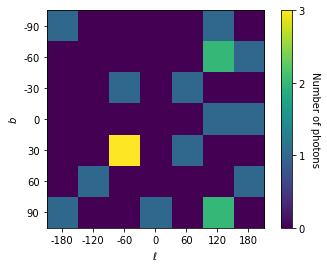

In [4]:
%matplotlib inline
fig, ax = plt.subplots(1)

data = [
    [1,0,0,0,0,1,0],
    [0,0,0,0,0,2,1],
    [0,0,1,0,1,0,0],
    [0,0,0,0,0,1,1],
    [0,0,3,0,1,0,0],
    [0,1,0,0,0,0,1],
    [1,0,0,1,0,2,0]
]


sky = ax.imshow(data, cmap='viridis')
ax.set_ylabel(r'$b$')
ax.yaxis.set_ticks([0, 1, 2, 3, 4, 5, 6])
ax.set_yticklabels(['-90', '-60', '-30', '0', '30', '60', '90'])
ax.set_xlabel(r'$\ell$')
ax.xaxis.set_ticks([0, 1, 2, 3, 4, 5, 6])
ax.set_xticklabels(['-180', '-120', '-60', '0', '60', '120', '180'])

cbar = plt.colorbar(sky)
cbar.ax.set_yticks([0, 1, 2, 3])
cbar.ax.set_yticklabels(['0','1','2','3'])
cbar.set_label('Number of photons', rotation=270, labelpad=15)

When we do RL deconvolution, we're asking "where do the photons land in this pixelated sky?"

The above illustration shows 19 photons distributed across the sky, which is projected onto a simple 2D plane. 

The RL algorithm finds the most likely image space position $(\ell, b)$ in which a photon was deposited given its recorded position by the instrument in detector coordinates. 

Because the response $R$ takes us from physical to measured units, ideally we'd like to simply apply the inverse of the response to our measured data. 

If we did this, then we'd have a simple mapping of our CDS (data space) right on to the sky (image space). 

However, the response matrix $R$ is not invertible! 

So instead of applying the inverse ($R^{-1}$), we apply the adjoint of the response ($R^{\dagger}$) to the data and get a sky distribution:

$R^{\dagger}D_{\phi, \psi, \chi} = S^{\dagger}(\ell, b)$ 

To first order, this gives us our familiar circles on the sky. However, this isn't great because we want an image, not a bunch of circles. This is where we turn to RL deconvolution.

Assume an initial image, typically a uniform map of some flux value. We fold it through the response, add it to the BG, and this becomes our complete expectation:

$R^{\dagger}(D_{\phi, \psi, \chi} - B_{\phi, \psi, \chi}) =$ image of the sky photons


This $B$ is the simulated background in the CDS from before. 

The data include some background, which we subtract out, and then apply the adjoint of the response to project this data from the CDS onto our image space. 

The next thing to consider in the RL technique is that the measurement process is not uniform. 

COSI has a field of view with points at different locations of the sky at different times. We don't simply "stare" at one point of the sky. 

Look at the equations in [this](https://ui.adsabs.harvard.edu/abs/1999A%26A...345..813K/abstract) COMPTEL paper for reference.

Eq. 1 shows how the RL algorithm iteratively improves the k$^{\text{th}}$ image. The denominator of the multiplicative term, which sums over the response in the CDS, is essentially our exposure map. Note that this can lead to edge effects in the final image: at poor exposures the denominator is small and the algorithm thinks that if we record any photon where there is poor exposure, that photon must be significant. This can create bright pixels where we have poor exposure. 

The numerator of the multiplicative term compares the expectation, $e = \Sigma(R \cdot \text{image} f + b)$, to the measured data, $n$. Note that $e$ is like our model $m$ and $n$ is like our data $d$, in the language above. $e$ and $n$ are in the CDS, and the subsequent application of the response gives moves us to the image space, where we get the delta image in Eq. 3.

This algorithm is slow, so we apply an "acceleration parameter". Lambda is determined in each iteration of the algorithm. Lambda draws upon the fact that we expect photons to fall in adjacent pixels (if we see a bunch of photons in a pixel, it's more likely that an adjacent pixel also has photons than a pixel really far away has one). By applying this weight to the delta image, we can speed up the algorithm. 

To ensure that image $f_j^{k+1}$ has positive intensities, we require that $\lambda^k \cdot \delta f_j^{k} > -f_j^{k}$.

In [6]:
#import response

In [2]:
rsp_file = '/volumes/eos/users/jacqueline/Response_1809/Isotropic.1809keV.binnedimaging.imagingresponse.rsp.gz'

In [3]:
test = response.SkyResponse(rsp_file,
                            pixel_size=6,from_saved_file=False)

In [4]:
test.ReadMEGAlibResponse()

Number of energy bins is 1, using reduced line response shape / omitting energy information ...


In [5]:
test.RebinToSquarePixelGrid(RegularPixelSize=6.)

Now calculating mapping function ...



Applying mapping function to all response entries, 30 phi bins times 1145 FISBEL bins, i.e. 34350 bins in total ...



Binned sky response contains 3465 (10.087336244541484%) non-zero entries: use reduced data space to save fit in fits!


<IPython.core.display.Javascript object>


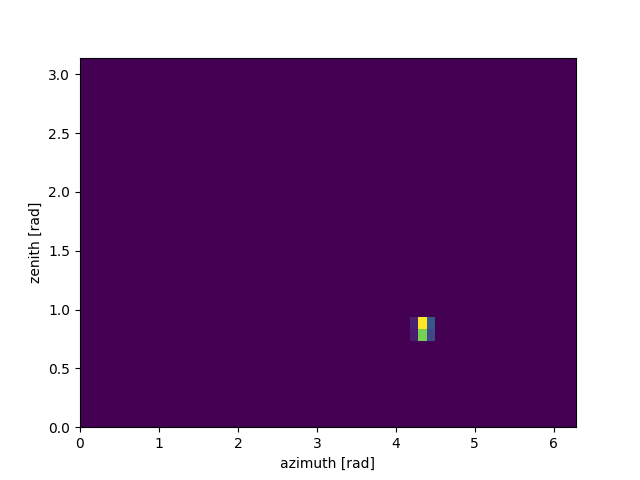

Text(0, 0.5, 'zenith [rad]')

In [6]:
plt.pcolormesh(test.l_edges, test.b_edges, test.rsp.mapping_function[200,:,:])
plt.xlabel('azimuth [rad]')
plt.ylabel('zenith [rad]')

In [7]:
test.rsp.response_grid_normed.shape

(30, 60, 30, 1145)

In [8]:
test.rsp.mapping_function.shape

(1145, 30, 60)

In [10]:
test.rsp.mapping_function[100,:,:]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

<IPython.core.display.Javascript object>


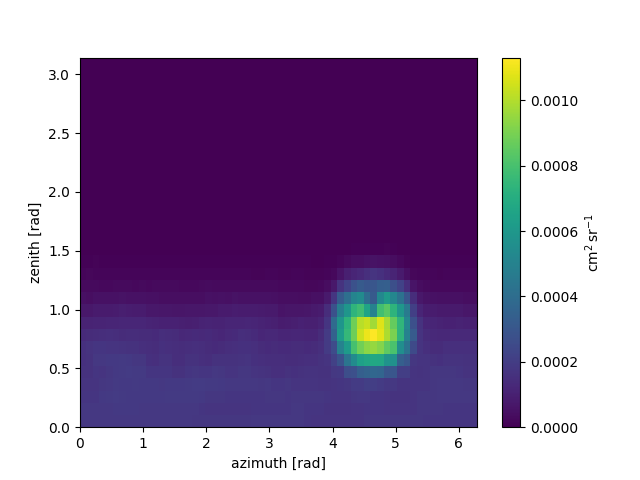

Text(0, 0.5, 'zenith [rad]')

In [11]:
tmp = np.sum(test.rsp.response_grid_normed,axis=2)#axis=4)

plt.pcolormesh(test.l_edges, test.b_edges, tmp[:,:,300])
plt.colorbar(label=r'$\mathrm{cm^2\,sr^{-1}}$')
plt.xlabel('azimuth [rad]')
plt.ylabel('zenith [rad]')

## Mess around with 3D plotting

In [12]:
x, y = np.meshgrid(test.l_edges[:-1], test.b_edges[:-1])

phi = 400
z = tmp[:,:,phi]

<IPython.core.display.Javascript object>


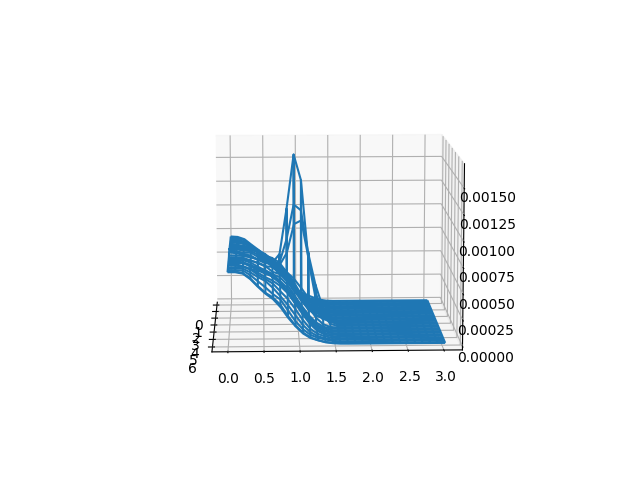

In [13]:
%matplotlib notebook
wf = plt.axes(projection='3d')
wf.plot_wireframe(x, y, z)

In [5]:

fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])

fig.update_traces(contours_z = dict(show=True, 
                                    usecolormap=True, 
                                    highlightcolor="limegreen", 
                                    project_z=True))


fig.update_layout(scene=dict(xaxis_title='azimuth [rad]',
                             yaxis_title='zenith [rad]',
                             zaxis_title=r'$cm^2 sr^{-1}$'),
                             title='CDS', 
                             autosize=False, 
                             width=900, height=700)

# scatter = fig.data[0]
# colors = ['#a3a7e4'] * 100
# scatter.marker.color = colors
# scatter.marker.size = [10] * 100
# fig.layout.hovermode = 'closest'


# # create our callback function
# def update_point(trace, points, selector):
#     c = list(scatter.marker.color)
#     s = list(scatter.marker.size)
#     for i in points.point_inds:
#         c[i] = '#bae2be'
#         s[i] = 20
#         with f.batch_update():
#             scatter.marker.color = c
#             scatter.marker.size = s


# scatter.on_click(update_point)

fig.show()

NameError: name 'z' is not defined

## Re-make Andreas' imaging paper figure

In [6]:
# first index is the photon origin
# second index is the compton scatter location
# third index is the post-scatter location
def points(lon, lat):
    x = [0, 0, lon]
    y = [0, 0, lat]
    z = [55, 25, 0]
    return x, y, z

def calculate_phi(lon, lat):
    compt_scatt_z = 25
    origin = [0, 0]
    dist = np.sqrt( (lon - origin[0])**2 + (lat - origin[1])**2 )
    phi = np.arctan(dist/compt_scatt_z)
    phi_deg = np.rad2deg(phi)
    return phi_deg

<IPython.core.display.Javascript object>


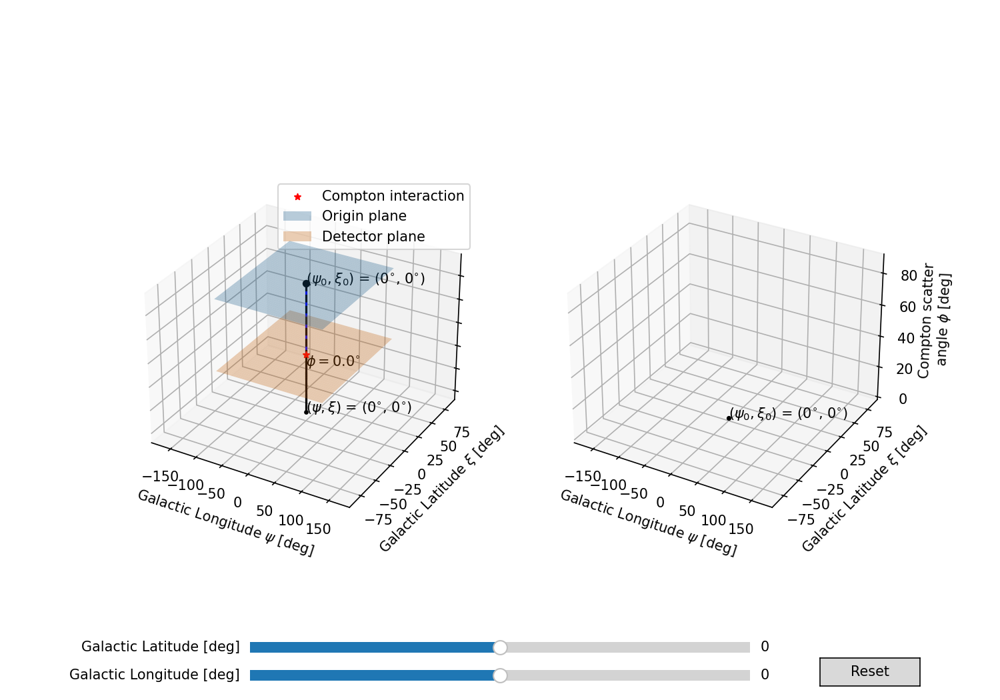

In [7]:
%matplotlib notebook

# Create 3D figure
fig = plt.figure(figsize=(10,7))

ax = fig.add_subplot(1, 2, 1, projection='3d')

ax2 = fig.add_subplot(1, 2, 2, projection='3d')
ax2.scatter(x[0], y[0], 0, c='k', s=6)
origin_annot_2 = ax2.text(x[0], y[0], 0,
                          r'($\psi_0, \xi_0$) = ({}'.format(x[0]) + 
                          r'$^{\circ}$' + ', {}'.format(y[0]) + r'$^{\circ}$)')

# Set axes
ax2.set_xlim(-180, 180)
ax2.set_ylim(-90, 90)
ax2.set_zlim(0, 90)
ax2.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
ax2.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
ax2.set_zlabel('Compton scatter' + '\n' + r' angle $\phi$ [deg]')


# Initially displayed longitude and latitude
init_lon = 0
init_lat = 0

# Get coordinates of origin, Compton scatter, and post-scatter interactions
x, y, z = points(lon=init_lon, lat=init_lat)

# Plot the above three points
ax.scatter(x[0], y[0], z[0], c='k')
ax.scatter(x[1], y[1], z[1], c='r',marker='*',label='Compton interaction')
ax.scatter(x[2], y[2], z[2], c='k', marker='.')

# Annotate origin point
origin_annot = ax.text(x[0], y[0], z[0],
                          r'($\psi_0, \xi_0$) = ({}'.format(x[0]) + 
                          r'$^{\circ}$' + ', {}'.format(y[0]) + r'$^{\circ}$)')

# Plot a line through all three points
line0 = ax.plot(x[:2], y[:2], z[:2],"b")
line, = ax.plot(x[1:], y[1:], z[1:], 'k')

# Plot a vertical dashed line along phi = 0
ax.plot([x[0], x[1]], [y[0], y[1]], [z[0], z[2]], 'k--')

# Calculate and annotate phi, given x and y 
phi = calculate_phi(init_lon, init_lat)
phi_annot = ax.text(0, 0, 20, r'$\phi = $' + str(round(phi,1)) + r'$^{\circ}$')

# Annotate x, y
xy_annot = ax.text(x[-1], y[-1], z[-1], r'($\psi, \xi$) = ({}'.format(round(x[-1], 1)) + 
                      r'$^{\circ}$' + ', {}'.format(round(y[-1], 1)) + r'$^{\circ}$)')

# Set axes
ax.set_xlim(-180, 180)
ax.set_ylim(-90, 90)
ax.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
ax.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
ax.zaxis.set_ticklabels([])


###########


# Plot origin plane
xx0, yy0 = np.meshgrid(range(-100,100), range(-60,60))
zz0 = np.full_like(xx0, z[0])
surf0 = ax.plot_surface(xx0, yy0, zz0, alpha=0.3, label="Origin plane")
surf0._edgecolors2d = surf0._edgecolor3d
surf0._facecolors2d = surf0._facecolor3d

# Plot detector plane
xx, yy = np.meshgrid(range(-100,100), range(-60,60))
zz = np.full_like(xx, z[1])
surf = ax.plot_surface(xx, yy, zz, alpha=0.3, label="Detector plane")
surf._edgecolors2d = surf._edgecolor3d
surf._facecolors2d = surf._facecolor3d


##########


# Create longitude and latitude sliders for post-scatter interaction
axlon = plt.axes([0.25, 0.02, 0.5, 0.03])
lon_slider = Slider(ax=axlon, label='Galactic Longitude [deg]', valmin=-180, valmax=180, valinit=init_lon)

axlat = plt.axes([0.25, 0.06, 0.5, 0.03])
lat_slider = Slider(ax=axlat, label='Galactic Latitude [deg]', valmin=-90, valmax=90, valinit=init_lat)

# Update the longitude and latitude values
def update(val):
    ax2.clear()
    
    x, y, z = points(lon_slider.val, lat_slider.val)
    line.set_data_3d(x[1:], y[1:], z[1:])
    
    xy_annot.set_text(r'($\psi, \xi$) = ({}'.format(round(x[-1], 1)) + 
                          r'$^{\circ}$' + ', {}'.format(round(y[-1], 1)) + r'$^{\circ}$)')
    
    # Update phi
    new_phi = round(calculate_phi(lon_slider.val, lat_slider.val), 1)
    phi_annot.set_text(r'$\phi = $' + str(new_phi) + r'$^{\circ}$')
    
    
    # Plot cone corresponding to new phi 
    height = new_phi
    radius = height*np.tan(np.pi/4.)
    a = 0  # x
    b = 0  # y
    c = 0  # z

    # Set up the grid in polar
    theta = np.linspace(0, 2*np.pi, 90)
    r = np.linspace(0, radius, 50)
    T, R = np.meshgrid(theta, r)

    # Then calculate X, Y, and Z
    X = R * np.cos(T) + a
    Y = R * np.sin(T) + b
    Z = np.sqrt(X**2 + Y**2) - 1

    # Set axes
    ax2.set_xlim(-180, 180)
    ax2.set_ylim(-90, 90)
    ax2.set_zlim(0, 90)
    ax2.set_xlabel(r'Galactic Longitude $\psi$ [deg]')
    ax2.set_ylabel(r'Galactic Latitude $\xi$ [deg]')
    ax2.set_zlabel('Compton scatter' + '\n' + r' angle $\phi$ [deg]')

    ax2.scatter(x[0], y[0], 0, c='k', s=6)
    origin_annot_2 = ax2.text(x[0], y[0], 0,
                              r'($\psi_0, \xi_0$) = ({}'.format(x[0]) + 
                              r'$^{\circ}$' + ', {}'.format(y[0]) + r'$^{\circ}$)')
    phi_annot_2 = ax2.text(0.75*radius, 0.75*radius, new_phi, 
                           r'$\phi$ = {}'.format(new_phi) + r'$^{\circ}$')
    ax2.plot_surface(X, Y, Z, alpha = 0.5)

    
    # Draw canvas
    fig.canvas.draw() 
    fig.canvas.flush_events()
    
    return new_phi
    

lon_slider.on_changed(update)
lat_slider.on_changed(update)


###########


# Create a reset button to reset lon and lat to initial values
resetax = plt.axes([0.82, 0.02, 0.1, 0.04])
button = Button(resetax, 'Reset', hovercolor='0.975')


def reset(event):
    lon_slider.reset()
    lat_slider.reset()
button.on_clicked(reset)


ax.legend();


In [13]:
# %matplotlib inline
# from matplotlib.patches import Circle
# fig, ax = plt.subplots()
# ax.scatter(0, 0)
# cir = plt.Circle((0, 0), 10, color='r',fill=False)
# ax.set_aspect('equal', adjustable='datalim')
# ax.add_patch(cir)

### Make the above in plotly

In [9]:
# def circle_given_phi(phi):
#     # theta goes from 0 to 2pi
#     theta = np.linspace(0, 2*np.pi, 100)

#     # the radius of the circle
#     r = 25*np.tan(np.radians(phi))

#     # compute x and y
#     x = r*np.cos(phi)#theta)
#     y = r*np.sin(phi)#theta)
    
#     return x, y

# def calculate_phi(lon, lat):
#     compt_scatt_z = 25
#     origin = [0, 0]
#     dist = np.sqrt( (lon - origin[0])**2 + (lat - origin[1])**2 )
#     phi = np.arctan(dist/compt_scatt_z)
#     phi_deg = np.rad2deg(phi)
#     return phi_deg

### Make a dataframe with phi values and possible lon/lat values

In [15]:
def calculate_phi(lon, lat):
    compt_scatt_z = 25
    origin = [0, 0]
    dist = np.sqrt( (lon - origin[0])**2 + (lat - origin[1])**2 )
    phi = np.arctan(dist/compt_scatt_z)
    phi_deg = np.rad2deg(phi)
    return phi_deg

inc = 1
lons = np.arange(-180, 180 + inc, inc)
lats = np.arange(-90, 90 + inc, inc)

d = {}

for lon in lons:
    for lat in lats:
        phi = round(calculate_phi(lon, lat), 1)
        
        #radius = np.sqrt(lon**2 + lat**2)
        
        if phi not in d:
            #d[phi] = [lon, lat, radius]
            d[phi] = [[lon], [lat], [radius]]
                      
        else:
            d[phi][0].append(lon)
            d[phi][1].append(lat)
            #d[phi][2].append(radius)

In [16]:
df = pd.DataFrame.from_dict(d, orient = 'index', columns=['lon', 'lat'])#, 'radius'])
df.index.name = 'phi'
df.head()

,lon,lat
phi,,
82.9,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-90, -89, -88, -87, -86, 86, 87, 88, 89, 90, ..."
82.8,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-85, -84, -83, -82, -81, -80, -79, 79, 80, 81..."
82.7,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-78, -77, -76, -75, -74, -73, -72, 72, 73, 74..."
82.6,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-71, -70, -69, -68, -67, -66, -65, 65, 66, 67..."
82.5,"[-180, -180, -180, -180, -180, -180, -180, -18...","[-64, -63, -62, -61, -60, -59, -58, -57, 57, 5..."


In [14]:
import io
from base64 import b64encode
buffer = io.StringIO()

x = [0, 0, 0] 
y = [0, 0, 0] 
z = [55, 25, 0]


# Plot origin point
init_point = go.Scatter3d(
                x = [x[0]], 
                y = [y[0]], 
                z = [z[0]],
                mode = 'markers',
                marker = dict(
                    size = 4,
                    color = 'black',
                    opacity = 0.8
                ),
                visible = True,
                name = 'Origin'
            )


# Compton interaction
scatter_point = go.Scatter3d(
                x = [x[1]], 
                y = [y[1]], 
                z = [z[1]],
                mode = 'markers',
                marker = dict(
                    size = 4,
                    color = 'red',
                    opacity = 0.8
                ),
                visible = True,
                name = 'Compton interaction'
            )


# Plot line to show inital path
init_path = go.Scatter3d(
                x = x[:2], 
                y = y[:2], 
                z = z[:2],
                mode = 'lines',
                line_color = 'black',
                opacity = 0.8,
                showlegend=False,
                visible = True
            )


# Define origin plane by its four corners
origin_plane = {'type': 'mesh3d',
               'x': [-90, -90, 90, 90],
               'y': [-180, 180, -180, 180],
               'z': [z[0], z[0], z[0], z[0]],
               'color': 'blue',
               'opacity': 0.3,
               'visible': True,
               'name': 'Origin plane'}


# Define detector plane by its four corners
detector_plane = {'type': 'mesh3d',
                   'x': [-90, -90, 90, 90],
                   'y': [-180, 180, -180, 180],
                   'z': [z[1], z[1], z[1], z[1]],
                   'color': 'orange',
                   'opacity': 0.3,
                   'visible': True,
                   'name': 'Detector plane'}


# Add scatter path and final interaction point
#  as a function of phi
traces = []
phis = df.index[::-1]

paths = []

for step in phis: 
    phi = step
    lon = df.loc[df.index == phi, 'lon'].tolist()[0]
    lat = df.loc[df.index == phi, 'lat'].tolist()[0]
    radius = df.loc[df.index == phi, 'radius'].tolist()[0]

    x_test = [x[1]] + lon#.insert(0, x[1])    
    y_test = [y[1]] + lat#.insert(0, x[1])
    z_test = [z[1]] + [0]*len(lat)
        
    trace = go.Scatter3d(
#                     x = x_test,#[x[1], lon], 
#                     y = y_test,#[y[1], lat], 
#                     z = z_test,#[z[1], 0],
                    x = lon,#[x[1], lon], 
                    y = lat,#[y[1], lat], 
                    z = [0]*len(lat),
                    mode = 'markers',#+lines',
                    marker = dict(
                        size = 3,#radius,
                        color = 'green',
                        opacity = 0.8
                    ),
                    text = [f'$\phi$ = {phi}' + r'$^{\circ}$'],
                    textposition = 'bottom right',
                    visible = False,
                    name = 'Possible post-scatter locations'
                    )
            
    traces.append(trace)
    
    # Plot line to show scatter path
    scatt_path = go.Scatter3d(
                x = [x[1], lon[0]], 
                y = [y[1], lat[0]], 
                z = [z[1], 0],
                mode = 'lines',
                line_color = 'green',
                opacity = 0.8,
                visible = False,
                name = 'Possible scatter path'
            )
    
    paths.append(scatt_path)


        
traces[0]['visible'] = True

paths[0]['visible'] = True


data = list(np.copy(traces)) + list(np.copy(paths))
data.extend([init_point, 
            scatter_point,
            init_path,
            origin_plane, 
            detector_plane])


# Create slider
steps = []
for i in range(len(traces)-1):
    step = dict(
        method = 'restyle',  
        args = ['visible', [False] * len(data), 
                {"title": "Compton scattering angle: " + str(phis[i]) + " deg"}],
        label = str(phis[i])
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible" (the scattered ray)
    step['args'][1][i + len(paths)] = True

    # Make the rest of the elements visible
    for j in range(len(traces) + len(paths), len(data)):
        step['args'][1][j] = True

    steps.append(step)


sliders = [dict(
    active = 0,
    currentvalue = {"prefix": "Compton scattering angle: ", "suffix": " deg"},
    pad = {"t": 5},
    steps = steps

)]


# Create the layout
layout = go.Layout(title = 'Compton scattering in the CDS',
                    width = 800,
                    height = 800,            
                    autosize = False,
                    sliders = sliders)

# Create the figure
fig = go.Figure(data = data, 
                layout = layout)


# Update axes in the figure
fig.update_layout(scene=dict(
                    xaxis_title='Galactic Longitude '+ r'$\xi$'+' [deg]',
                    xaxis = dict(
                                tickmode = 'array',
                                tickvals = [-90, -60, -30, 0, 30, 60, 90]
                                ),
    
                    yaxis_title='Galactic Longitude '+ r'$\psi$'+' [deg]',
                    yaxis = dict(
                                tickmode = 'array',
                                tickvals = [-180, -120, -60, 0, 60, 120, 180]
                                ),
    
                    zaxis_title='',
                    zaxis = dict(
                                tickmode = 'array',
                                tickvals = []
                                )
                     )
                 )

# # Plot circle on sky
# Add traces, one for each slider step

# for step in df.index[:5]: # np.arange(0, 5, 0.1):
#     phi = step
#     lon = df.loc[df.index == phi,'lon'].tolist()[0]
#     lat = df.loc[df.index == phi,'lat'].tolist()[0]
#     radius = df.loc[df.index == phi,'radius'].tolist()[0]
    
# #     fig.add_shape(type="circle",
# #         xref = "x", yref = "y",
# #         fillcolor = None,
# #         x0 = -radius, y0 = -radius, x1 = radius, y1 = radius,
# #         line_color = "LightSeaGreen",


fig.show()


# # Export as html
# fig.write_html(buffer)

# html_bytes = buffer.getvalue().encode()
# encoded = b64encode(html_bytes).decode()

# app = dash.Dash()

### PNG functionality not working?
# app.layout = html.Div([
#     html.H4('Simple plot export options'),
#     html.P("↓↓↓ try downloading the plot as PNG ↓↓↓", style={"text-align": "right", "font-weight": "bold"}),
#     dcc.Graph(id="graph", figure=fig),
#     html.A(
#         html.Button("Download as HTML"), 
#         id="download",
#         href="data:text/html;base64," + encoded,
#         download="cds_vis.html"
#     )
# ])

# app.run_server(debug=True, use_reloader=False)